Our model had poor results when we tested it on full merged images -- we thought we may have overtrained it, so we decided to start fresh in a new notebook and decided to separate out training, test and validation data to make sure the computer was testing on new data it had never seen before. We also decided to add some of the same training images but rotated to see if that helped the model better recognize encampments and non-encampments.

In [ ]:
#Required packages
# pip3 install tensorflow pillow matplotlib numpy scikit-image scikit-learn xgboost seaborn joblib ipykernel

###
# Machine learning libraries
###

# TensorFlow: An open-source platform for machine learning, used here for feature extraction with ResNet
# URL: https://www.tensorflow.org/
#note: if having issues with tensorflow, try changing your python kernel to another kind
import tensorflow as tf
from tensorflow.keras.applications import ResNet50  # Pre-trained ResNet50 model for feature extraction
from tensorflow.keras.preprocessing import image  # Utilities for image preprocessing
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions  # Functions for preprocessing input and decoding predictions
from tensorflow.keras.preprocessing.image import load_img, img_to_array


# Scikit-learn: A machine learning library for Python, used here for data preprocessing and evaluation
# URL: https://scikit-learn.org/
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold  # For splitting data into training and testing sets
from sklearn.preprocessing import LabelEncoder  # For encoding labels as integers
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, f1_score, recall_score  # For evaluating model performance

# Scikit-image: A collection of algorithms for image processing
# URL: https://scikit-image.org/
from skimage import io  # For reading and writing images
from skimage.segmentation import slic, mark_boundaries  # For segmenting images and marking boundaries
from skimage.util import img_as_float  # For converting images to floating point format
from skimage.measure import regionprops  # For measuring properties of labeled image regions


# XGBoost: An optimized distributed gradient boosting library, used here for building the classification model
# URL: https://xgboost.readthedocs.io/
from xgboost import XGBClassifier
import xgboost as xgb

###
# Data visualization libraries
### 

# Matplotlib: A plotting library for creating static, animated, and interactive visualizations
# URL: https://matplotlib.org/
import matplotlib.pyplot as plt

# Seaborn: A Python visualization library based on matplotlib, used here for statistical data visualization
# URL: https://seaborn.pydata.org/
import seaborn as sns


###
# Other useful stuff
###
# Pandas: A fast, powerful, flexible, and easy-to-use open-source data analysis and data manipulation library
# URL: https://pandas.pydata.org/
import pandas as pd

# NumPy: A fundamental package for scientific computing with Python, used here for handling arrays
# URL: https://numpy.org/
import numpy as np

# PIL (Pillow): Python Imaging Library for opening, manipulating, and saving images
# URL: https://pillow.readthedocs.io/
from PIL import Image

# SciPy: A Python library used for scientific and technical computing
# URL: https://www.scipy.org/
from scipy import misc, ndimage  # For miscellaneous image processing tasks and multi-dimensional image processing

# Joblib: A set of tools to provide lightweight pipelining in Python, used here for saving and loading models
# URL: https://joblib.readthedocs.io/
import joblib

# OS: A module providing a way of using operating system dependent functionality
# URL: https://docs.python.org/3/library/os.html
import os
from os import listdir  # For listing directory contents
from os.path import isfile, join  # For file path manipulations

import shutil
import random


### STEP 1. Split up training, test and validation data

In [2]:
#make a function to split the data into train, validation, and test sets and store in separate directories
def split_data(source_dir, train_dir, val_dir, test_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    # Ensure the ratios sum to 1
    assert train_ratio + val_ratio + test_ratio == 1.0, "Train, validation, and test ratios must sum to 1"

    # Create directories if they don't exist
    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(val_dir, exist_ok=True)
    os.makedirs(test_dir, exist_ok=True)

    # Get list of all files in the source directory
    all_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f))]
    random.shuffle(all_files)

    # Calculate the number of files for each split based on the ratios we set when we defined the function
    total_files = len(all_files)
    train_count = int(total_files * train_ratio)
    val_count = int(total_files * val_ratio)
    test_count = total_files - train_count - val_count

    # Split the files
    train_files = all_files[:train_count]
    val_files = all_files[train_count:train_count + val_count]
    test_files = all_files[train_count + val_count:]

    # Copy the files to their directories
    for f in train_files:
        shutil.copy(os.path.join(source_dir, f), os.path.join(train_dir, f))
    for f in val_files:
        shutil.copy(os.path.join(source_dir, f), os.path.join(val_dir, f))
    for f in test_files:
        shutil.copy(os.path.join(source_dir, f), os.path.join(test_dir, f))

    print(f"Copied {train_count} files to {train_dir}")
    print(f"Copied {val_count} files to {val_dir}")
    print(f"Copied {test_count} files to {test_dir}")

# Example usage - this is how you should use these functions in your code
positive_source_dir = "./model/datasets/positive_tiles"
negative_source_dir = "./model/datasets/negative_tiles"

train_dir = "./model/datasets/train"
val_dir = "./model/datasets/val"
test_dir = "./model/datasets/test"

# Create subdirectories for positive and negative files in train, val, and test directories
train_positive_dir = os.path.join(train_dir, "positive")
val_positive_dir = os.path.join(val_dir, "positive")
test_positive_dir = os.path.join(test_dir, "positive")

train_negative_dir = os.path.join(train_dir, "negative")
val_negative_dir = os.path.join(val_dir, "negative")
test_negative_dir = os.path.join(test_dir, "negative")

# Split positive files - basically just run the functions on these directories
split_data(positive_source_dir, train_positive_dir, val_positive_dir, test_positive_dir)

# Split negative files - same as earlier
split_data(negative_source_dir, train_negative_dir, val_negative_dir, test_negative_dir)

Copied 58 files to ./model/datasets/train/positive
Copied 12 files to ./model/datasets/val/positive
Copied 14 files to ./model/datasets/test/positive
Copied 56 files to ./model/datasets/train/negative
Copied 12 files to ./model/datasets/val/negative
Copied 12 files to ./model/datasets/test/negative


Now, let's take a look at our training data.

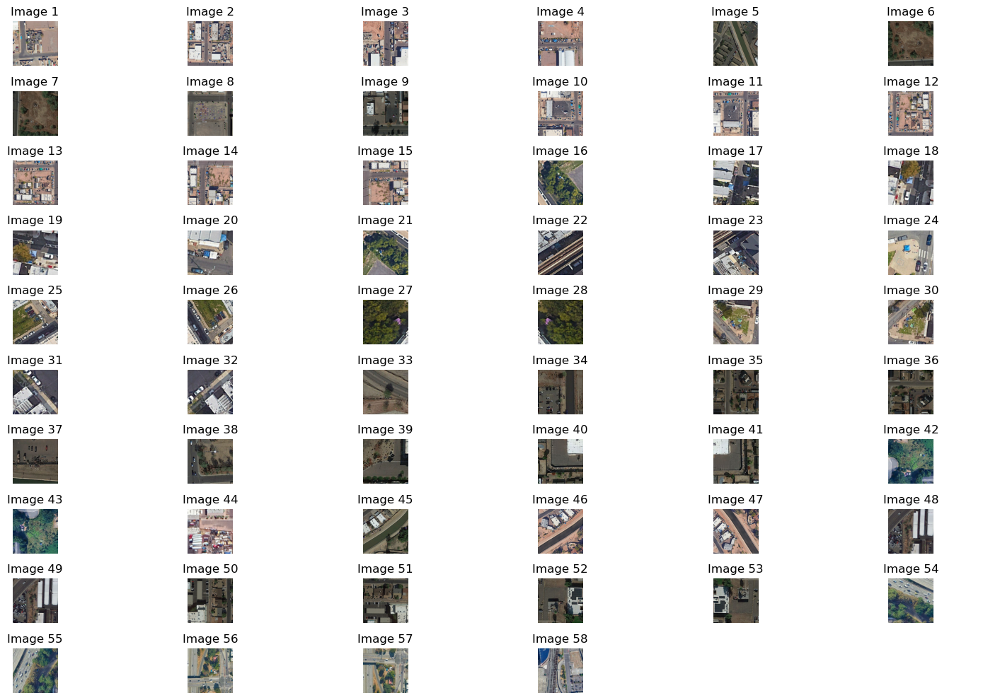

In [5]:
# Tell model where to find positive training images (images with homeless encampments identified)
positive_img_path =  "./model/datasets/train/positive/"  

# Get the list of image files
image_files = sorted([f for f in listdir(positive_img_path) if isfile(join(positive_img_path, f))])

# Select the first 60 images (setting to 60 for now, hoping we will be able to add more)
image_files = image_files[:60]

# Create a grid to display the images - make space for 10 rows of 6 images each
fig, axes = plt.subplots(10, 6, figsize=(15, 10))

# Iterate over the axes and image files to display each image on a grid
for i, ax in enumerate(axes.flat):
    if i < len(image_files):
        img = Image.open(join(positive_img_path, image_files[i]))
        ax.imshow(img)
        ax.set_title(f"Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

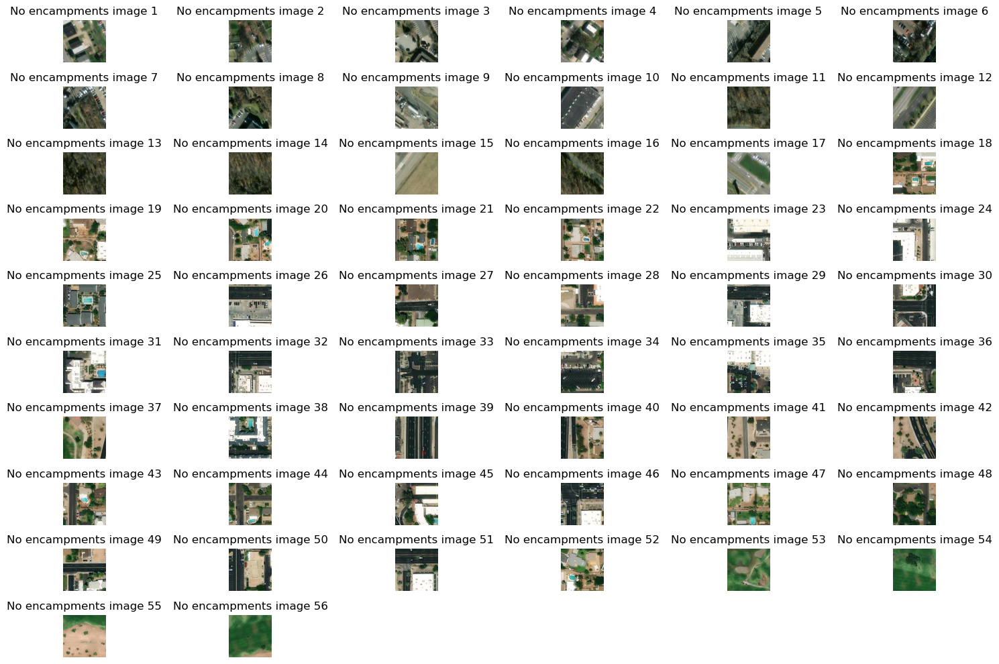

In [6]:

# where to find negative images with no encampments
negative_img_path =  "./model/datasets/train/negative/"  

# Get the list of image files in the negative examples folder
image_files = sorted([f for f in listdir(negative_img_path) if isfile(join(negative_img_path, f))])

# Select the first 60 images (hopefully we will be able to add more)
image_files = image_files[:60]

# Create a grid to display the images
fig, axes = plt.subplots(10, 6, figsize=(15, 10))

# Iterate over the axes and image files to display each image on a grid
for i, ax in enumerate(axes.flat):
    if i < len(image_files):
        img = Image.open(join(negative_img_path, image_files[i]))
        ax.imshow(img)
        ax.set_title(f"No encampments image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

### STEP 2. Preprocess data and extract features using Scikitlearn and ResNet50

In [8]:
#create a function to resize the image and convert it to a numpy array (preprocess the images)
def load_and_preprocess_image(image_path, target_size=(224, 224)):
    """
    Load and preprocess a single image using only PIL
    """
    # Load the image using PIL
    img = Image.open(image_path)
    # Resize
    img = img.resize(target_size)
    # Convert to array
    img_array = np.array(img)
    return img_array

def load_data_from_directories(train_dir, val_dir, test_dir, feature_extractor):
    """
    Load and process data from train, validation, and test directories
    """
    def process_directory(directory):
        features = []
        labels = []
        paths = []
        
        # Process positive examples
        pos_dir = os.path.join(directory, "positive")
        for img_name in os.listdir(pos_dir):
            if img_name.endswith(('.png', '.jpg', '.jpeg')):
                img_path = os.path.join(pos_dir, img_name)
                try:
                    # Load and preprocess the image
                    img = load_and_preprocess_image(img_path)
                    # Extract features using ResNet50
                    feature = feature_extractor.predict(np.expand_dims(img, axis=0), verbose=0)
                    # Flatten the features
                    feature = feature.flatten()
                    
                    features.append(feature)
                    labels.append('positive')
                    paths.append(img_path)
                except Exception as e:
                    print(f"Error processing {img_path}: {str(e)}")
        
        # Process negative examples
        neg_dir = os.path.join(directory, "negative")
        for img_name in os.listdir(neg_dir):
            if img_name.endswith(('.png', '.jpg', '.jpeg')):
                img_path = os.path.join(neg_dir, img_name)
                try:
                    img = load_and_preprocess_image(img_path)
                    feature = feature_extractor.predict(np.expand_dims(img, axis=0), verbose=0)
                    feature = feature.flatten()
                    
                    features.append(feature)
                    labels.append('negative')
                    paths.append(img_path)
                except Exception as e:
                    print(f"Error processing {img_path}: {str(e)}")
        
        return np.array(features), np.array(labels), paths

    # Process each directory - run this code over training, validation and test data directories to get
    #features for all three
    print("Loading training data...")
    train_features, train_labels, train_paths = process_directory(train_dir)
    
    print("Loading validation data...")
    val_features, val_labels, val_paths = process_directory(val_dir)
    
    print("Loading test data...")
    test_features, test_labels, test_paths = process_directory(test_dir)
    
    # Use LabelEncoder to convert string labels to integers
    label_encoder = LabelEncoder()
    train_labels_encoded = label_encoder.fit_transform(train_labels)
    val_labels_encoded = label_encoder.transform(val_labels)
    test_labels_encoded = label_encoder.transform(test_labels)
    
    print(f"Loaded {len(train_features)} training samples")
    print(f"Loaded {len(val_features)} validation samples")
    print(f"Loaded {len(test_features)} test samples")
    
    return (train_features, train_labels_encoded, train_paths,
            val_features, val_labels_encoded, val_paths,
            test_features, test_labels_encoded, test_paths)

Next, let's use ResNet50 to define the features in our training data. We replaced the old code from the previous iteration with the code below to adjust for adding scikit learn earlier and added test, train and validation directories.

In [10]:
# Load ResNet50
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

# Define directories
train_dir = "./model/datasets/train"
val_dir = "./model/datasets/val"
test_dir = "./model/datasets/test"

# Load and process the data (will automatically save features to CSV)
(train_features, train_labels, train_paths,
 val_features, val_labels, val_paths,
 test_features, test_labels, test_paths) = load_data_from_directories(
    train_dir, val_dir, test_dir, resnet
)

Loading training data...
Loading validation data...
Loading test data...
Loaded 114 training samples
Loaded 24 validation samples
Loaded 26 test samples


## Step 3. Train our model

In [11]:
###
# Define our XGBoost classifier - this basically lets us tweak the model under the hood
###

# Initialize the XGBoost classifier with specific hyperparameters and store it as clf for later use.
#Did some tweaking to the XGBoost classifier to adjust for our smaller dataset based on feedback from Claude 
# - ultimately once I got to reducing the minimum child weight, I was able to get the model to 100 percent accuracy from 100 percent false positives in original iteration

clf = XGBClassifier(
    learning_rate=0.005,  # Step size shrinkage used to prevent overfitting. Range: [0,.005]
    #changed this to 0.005 from 0.01 because our dataset is small
    n_estimators=1000,  # Number of gradient boosted trees. Large value can lead to overfitting.
    #dropped this from 5000 to 1000 because it's better for a smaller dataset - dropped further to 500 after implementing early stopping
    max_depth=2,  # Maximum depth of a tree. Increasing this value makes the model more complex and more likely to overfit.
    #Reduced to 3 to reduce false positives, prevent memorizing training data? - dropped to 2 after adding more data to handle false negatives
    min_child_weight=4,  # Minimum sum of instance weight (hessian) needed in a child. Used to control overfitting.
    #dropped from 6 to allow learning from smaller groups ASK CLAUDE ABOUT THIS
    gamma=0.2,  # Minimum loss reduction required to make a further partition on a leaf node. The larger, the more conservative the algorithm will be.
    #bumped up to 0.2 to help with false positives - 
    subsample=0.8,  # Subsample ratio of the training instances. Prevents overfitting by sampling X% of the training data.
    colsample_bytree=0.8,  # Subsample ratio of columns when constructing each tree. Prevents overfitting by sampling X% of the features.
    reg_alpha=0.01,  # L1 regularization term on weights. Increasing this value makes the model more conservative.
    #bumepd to .01 ASK CLAUDE ABOUT THIS
    objective='binary:logistic',  # Specifies the learning task and the corresponding learning objective. Here, it's binary classification.
    nthread=7,  # Number of parallel threads used to run XGBoost. Adjust based on your system's capabilities.
    scale_pos_weight=1.8,  # Balancing of positive and negative weights. Useful for unbalanced classes.
    #changed this to account for the higher number of negative examples in our dataset
    seed=27  # Random seed for reproducibility.
)

###
# Fit the XGBoost classifier to the training data (aka build the model)

# Splitting some data off for validation - this is part of implementing early stopping.
#We use the validation set to figure out when to stop the model 
clf.fit(
    train_features,  # Our training features from load_data_from_directories
    train_labels,    # Our training labels from load_data_from_directories
    eval_set=[(val_features, val_labels)],  # Using our validation set
    verbose=True
)

# Save the model using XGBoost's Booster class
booster = clf.get_booster()
booster.save_model('model/versions/xgb_model.json')


[0]	validation_0-logloss:0.73477
[1]	validation_0-logloss:0.73178
[2]	validation_0-logloss:0.72918
[3]	validation_0-logloss:0.72697
[4]	validation_0-logloss:0.72424
[5]	validation_0-logloss:0.72023
[6]	validation_0-logloss:0.71739
[7]	validation_0-logloss:0.71326
[8]	validation_0-logloss:0.71081
[9]	validation_0-logloss:0.70873
[10]	validation_0-logloss:0.70570
[11]	validation_0-logloss:0.70262
[12]	validation_0-logloss:0.70021
[13]	validation_0-logloss:0.69603
[14]	validation_0-logloss:0.69203
[15]	validation_0-logloss:0.68986
[16]	validation_0-logloss:0.68606
[17]	validation_0-logloss:0.68491
[18]	validation_0-logloss:0.68237
[19]	validation_0-logloss:0.68002
[20]	validation_0-logloss:0.67625
[21]	validation_0-logloss:0.67376
[22]	validation_0-logloss:0.67153
[23]	validation_0-logloss:0.66937
[24]	validation_0-logloss:0.66590
[25]	validation_0-logloss:0.66313
[26]	validation_0-logloss:0.66044
[27]	validation_0-logloss:0.65678
[28]	validation_0-logloss:0.65373
[29]	validation_0-loglos

Now let's run some cross-validation tests to see how accurate our model is.

In [12]:
# Create the cross validator - splits our data into 5 parts to do 5 tests and compare results
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=27)

# Perform cross-validation with our training features and labels
scores = cross_val_score(clf, train_features, train_labels, cv=cv, scoring='accuracy')
precision_scores = cross_val_score(clf, train_features, train_labels, cv=cv, scoring='precision')

#add recall and f1 scores to better evaluate our model's performance
recall_scores = cross_val_score(clf, train_features, train_labels, cv=cv, scoring='recall')
f1_scores = cross_val_score(clf, train_features, train_labels, cv=cv, scoring='f1')

print("Cross-validation Results:")
print(f"Accuracy scores: {scores}")
print(f"Average accuracy: {scores.mean():.3f} (+/- {scores.std() * 2:.3f})")
print(f"\nPrecision scores: {precision_scores}")
print(f"Average precision: {precision_scores.mean():.3f} (+/- {precision_scores.std() * 2:.3f})")
print(f"\nRecall scores: {recall_scores}")
print(f"Average recall: {recall_scores.mean():.3f} (+/- {recall_scores.std() * 2:.3f})")
print(f"\nF1 scores: {f1_scores}")
print(f"Average F1: {f1_scores.mean():.3f} (+/- {f1_scores.std() * 2:.3f})")

Cross-validation Results:
Accuracy scores: [0.86956522 1.         0.95652174 0.95652174 0.95454545]
Average accuracy: 0.947 (+/- 0.085)

Precision scores: [0.90909091 1.         1.         1.         0.91666667]
Average precision: 0.965 (+/- 0.085)

Recall scores: [0.83333333 1.         0.91666667 0.90909091 1.        ]
Average recall: 0.932 (+/- 0.126)

F1 scores: [0.86956522 1.         0.95652174 0.95238095 0.95652174]
Average F1: 0.947 (+/- 0.085)


It looks like separating out our validation data. training data and testing data actually did improve accuracy and precision by a fair amount. This could change with more data available but it looks like it helped from what I can tell.

## 5. Evaluate the model

* Review a "confusion matrix" to get an overview of perfomrance. 
* Review some assessment metrics: precision, recall, accuracy, fscore.
* Look closely at images it classified correctly and incorrectly.

Let's try running our model on our merged photos with confirmed encampments and no encampments.

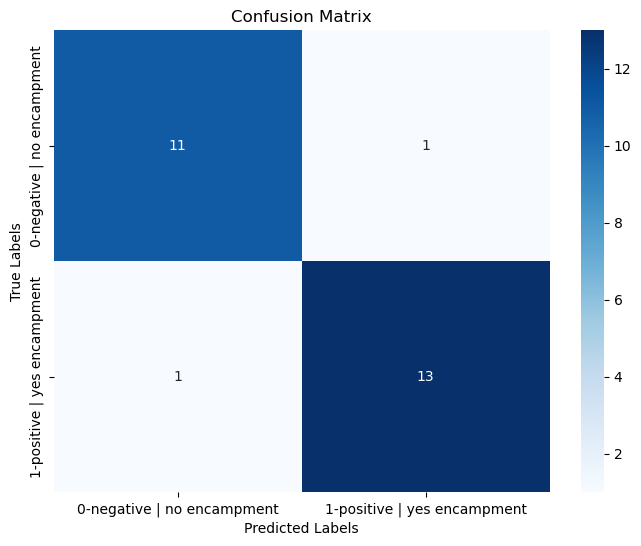

MODEL METRICS
_________
Precision: 0.9286
Recall: 0.9286
F1-Score: 0.9286
Accuracy: 0.9231


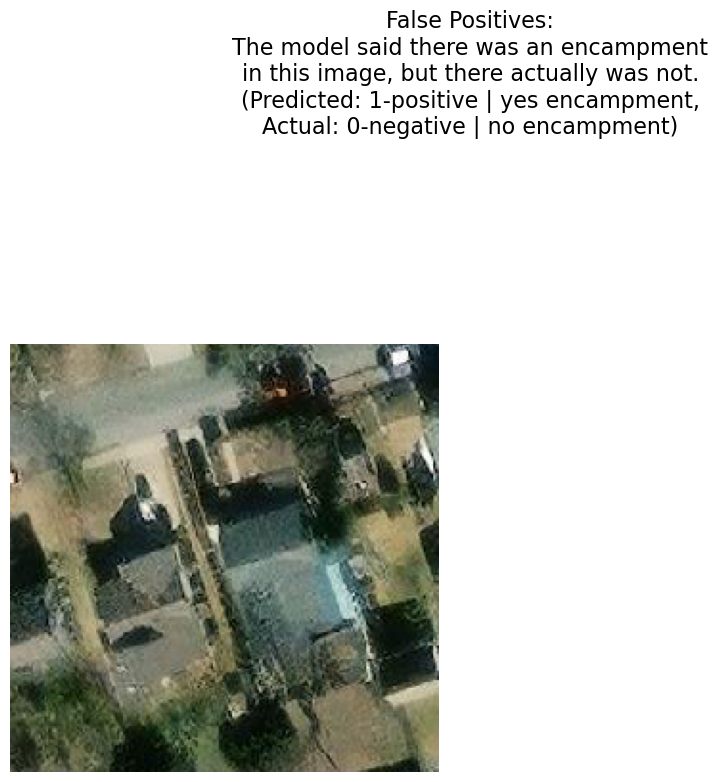

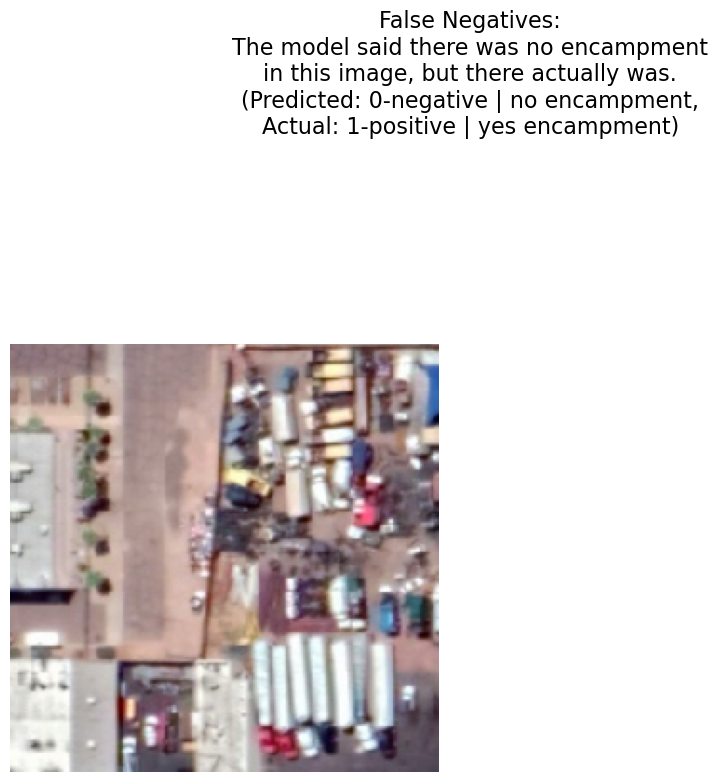

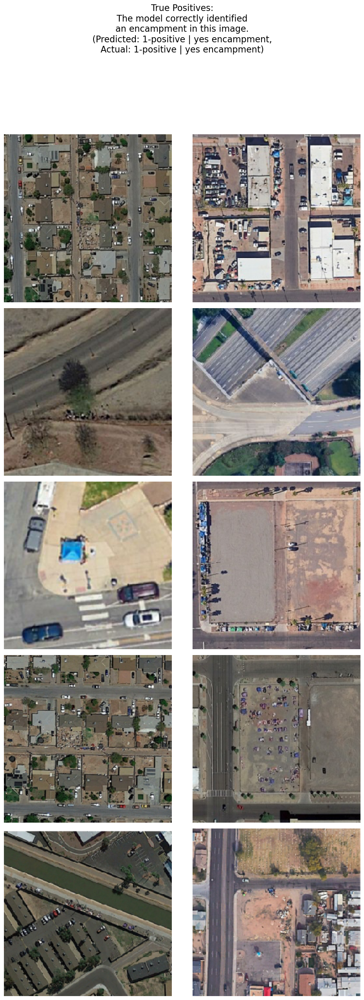

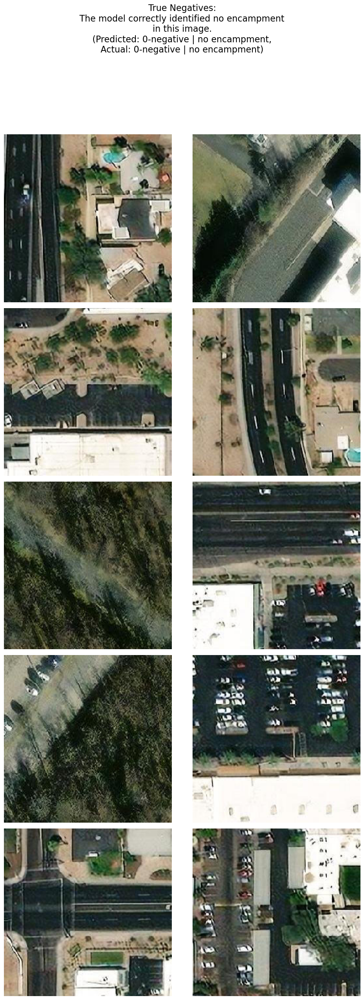

In [17]:
###
# Define function to output evaluation information
###

def evaluate(y_true, y_pred, image_paths):

    ###
    # Output a confusion matrix
    ###

    # Compute confusion matrix - this shows us how many true positives, false positives, true negatives, and false negatives we have
    cm = confusion_matrix(y_true, y_pred)
    
    # Create a heatmap for the confusion matrix - I think this just adds color to the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['0-negative | no encampment', '1-positive | yes encampment'], 
                yticklabels=['0-negative | no encampment', '1-positive | yes encampment'])
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()
    
    ###
    # Output statistics
    ###

    # Calculate the precision of the predictions - measures how accurate our positive predictions are
    precision = precision_score(y_true, y_pred, pos_label=1)

    # Calculate the recall of the predictions - ratio of correctly predicted positive observations to all observations in the actual class
    # It is a measure of the ability of the model to find all the relevant cases within a dataset
    recall = recall_score(y_true, y_pred, pos_label=1)

    # Calculate the F1 score of the predictions - weighted average of Precision and Recall
    f1 = f1_score(y_true, y_pred, pos_label=1)

    # Calculate the accuracy of the predictions
    # It is the most intuitive performance measure and it is simply a ratio of correctly predicted observation to the total observations
    accuracy = accuracy_score(y_true, y_pred)
    

    print(f"MODEL METRICS")
    print(f"_________")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    
    ###
    # Output examples of correct and incorrect predicions
    ###

    # Identify the indices of false positives, false negatives, true positives, and true negatives
    false_positives = np.where((y_pred == 1) & (y_true == 0))[0]
    false_negatives = np.where((y_pred == 0) & (y_true == 1))[0]
    true_positives = np.where((y_pred == 1) & (y_true == 1))[0]
    true_negatives = np.where((y_pred == 0) & (y_true == 0))[0]

    # Extract image paths for each category using list comprehension
    fp_images = [image_paths[i] for i in false_positives]
    fn_images = [image_paths[i] for i in false_negatives]
    tp_images = [image_paths[i] for i in true_positives]
    tn_images = [image_paths[i] for i in true_negatives]
    
    # Display image grids with updated headings for each category
    display_image_grid(
        fp_images, 
        'False Positives:\nThe model said there was an encampment\nin this image, but there actually was not.\n(Predicted: 1-positive | yes encampment,\nActual: 0-negative | no encampment)'
    )
    display_image_grid(
        fn_images, 
        'False Negatives:\nThe model said there was no encampment\nin this image, but there actually was.\n(Predicted: 0-negative | no encampment,\nActual: 1-positive | yes encampment)'
    )
    display_image_grid(
        tp_images, 
        'True Positives:\nThe model correctly identified\nan encampment in this image.\n(Predicted: 1-positive | yes encampment,\nActual: 1-positive | yes encampment)'
    )
    display_image_grid(
        tn_images, 
        'True Negatives:\nThe model correctly identified no encampment\nin this image.\n(Predicted: 0-negative | no encampment,\nActual: 0-negative | no encampment)'
    )

###
# Function to display image grid
###

def display_image_grid(image_paths, title, num_images=10):
    """Display a grid of images from a list of image paths in a 2-column layout."""
    num_rows = (num_images + 1) // 2  # Calculate the number of rows needed for 2 columns
    plt.figure(figsize=(10, num_rows * 5))  # Adjust the figure size based on rows

    for i, img_path in enumerate(image_paths[:num_images]):
        img = image.load_img(img_path, target_size=(224, 224))  # Load image
        plt.subplot(num_rows, 2, i + 1)  # Arrange in a 2-column grid
        plt.imshow(img)
        plt.axis('off')  # Hide axes for a cleaner display

    # Ensure enough space between title and images
    plt.suptitle(title, fontsize=16, ha='center', va='top', y=1.02)  # Move the title higher
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to prevent overlap
    plt.show()

###
# Run evaluation function
###

# Make predictions on the test set
Y_pred = clf.predict(test_features)

# Evaluate the model and display the image grids with updated titles and proper spacing
evaluate(test_labels, Y_pred, test_paths) 


It looks like when we see the confusion matrix, our model seems to be performing similarly although our test set is very small now. Finally, let's try running this on the merged images again.

encampment detected!
Number of segments: 23
Number of labels: 23


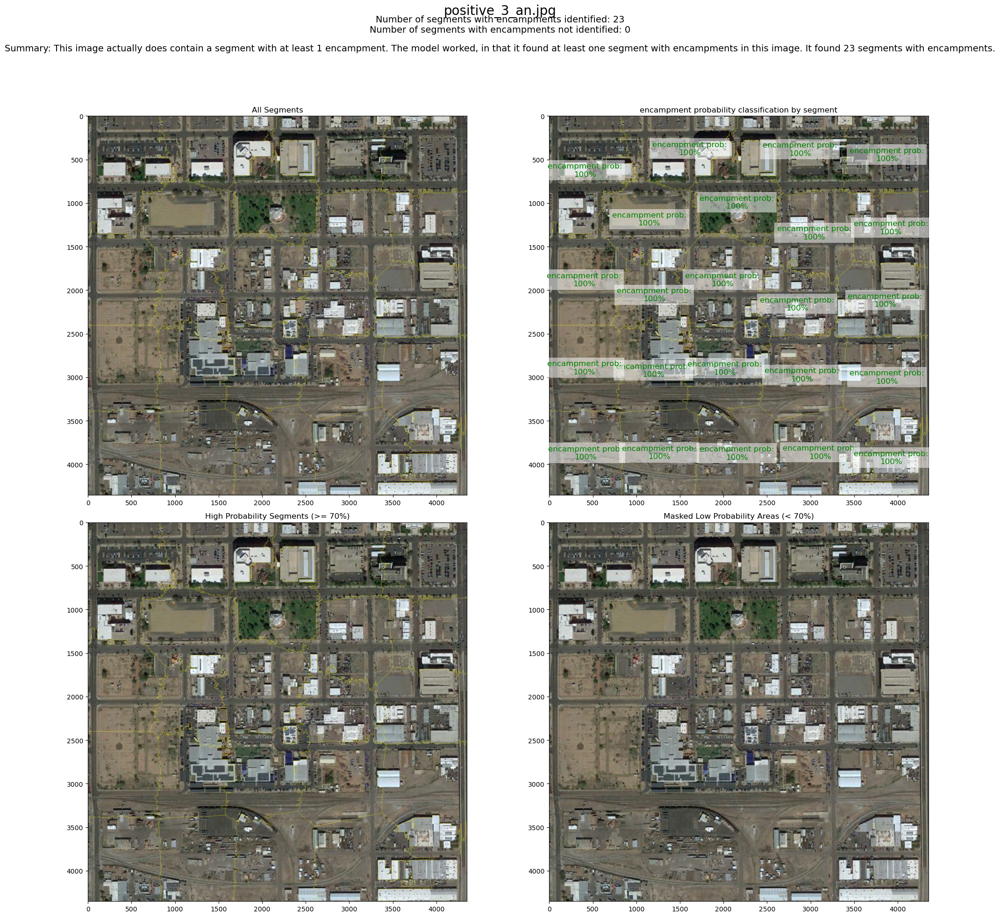

encampment detected!
Number of segments: 22
Number of labels: 22


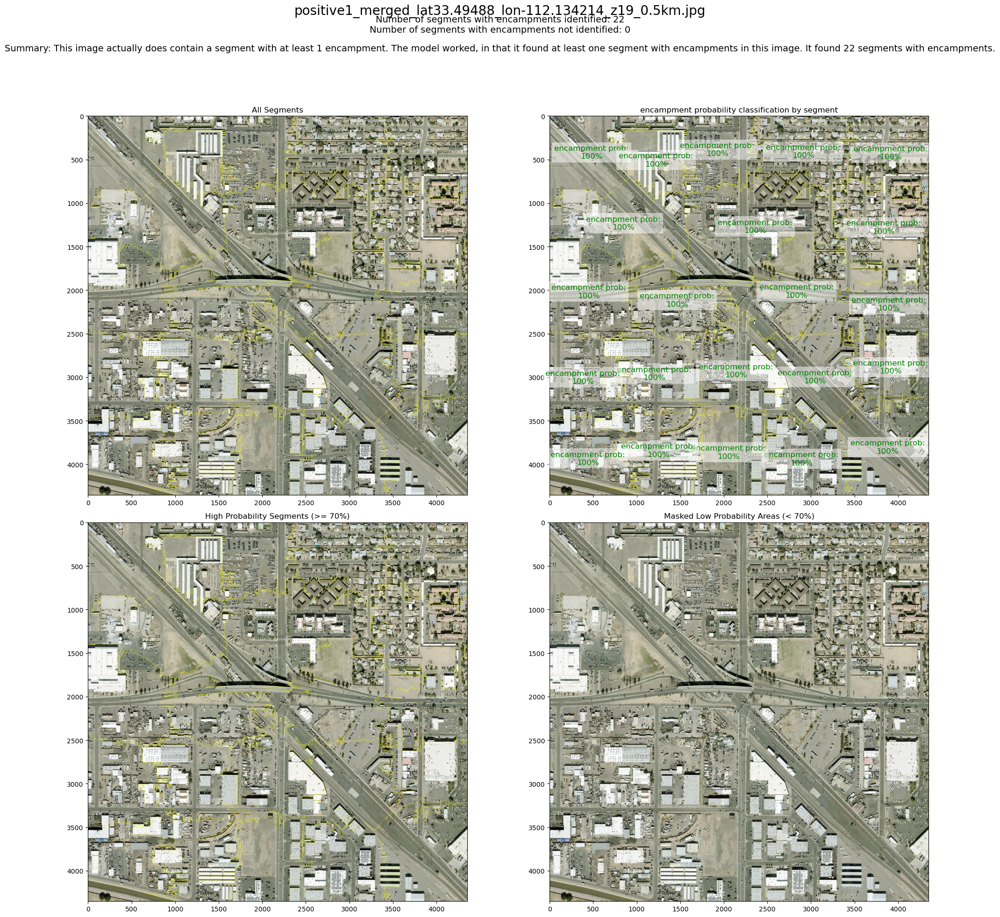

encampment detected!
Number of segments: 24
Number of labels: 24


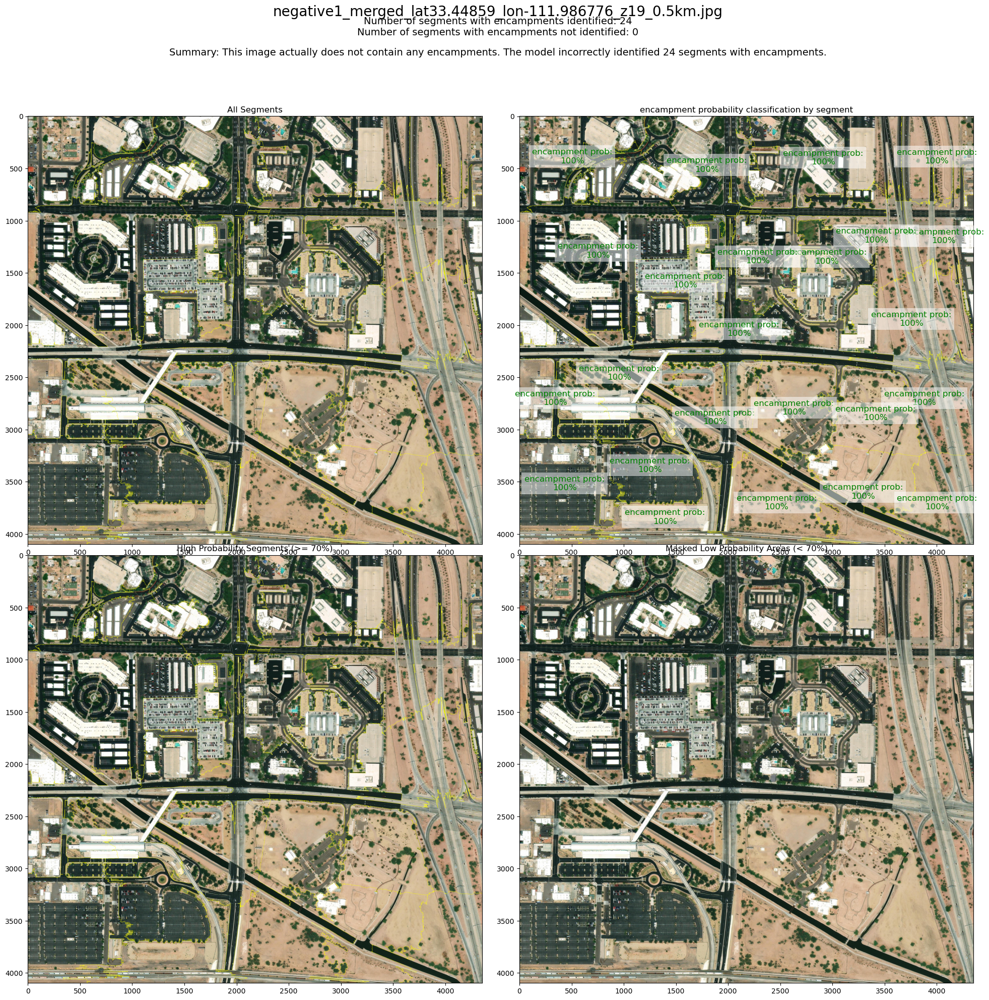

encampment detected!
Number of segments: 17
Number of labels: 17


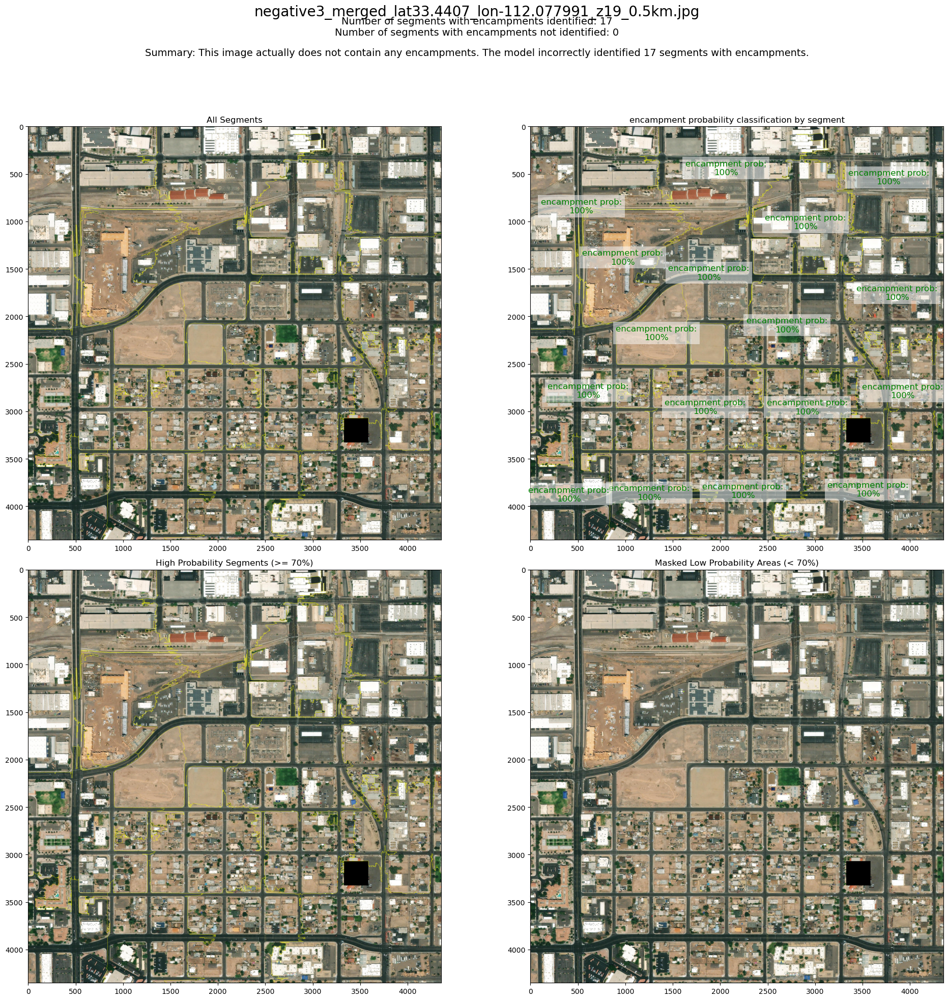

encampment detected!
Number of segments: 23
Number of labels: 23


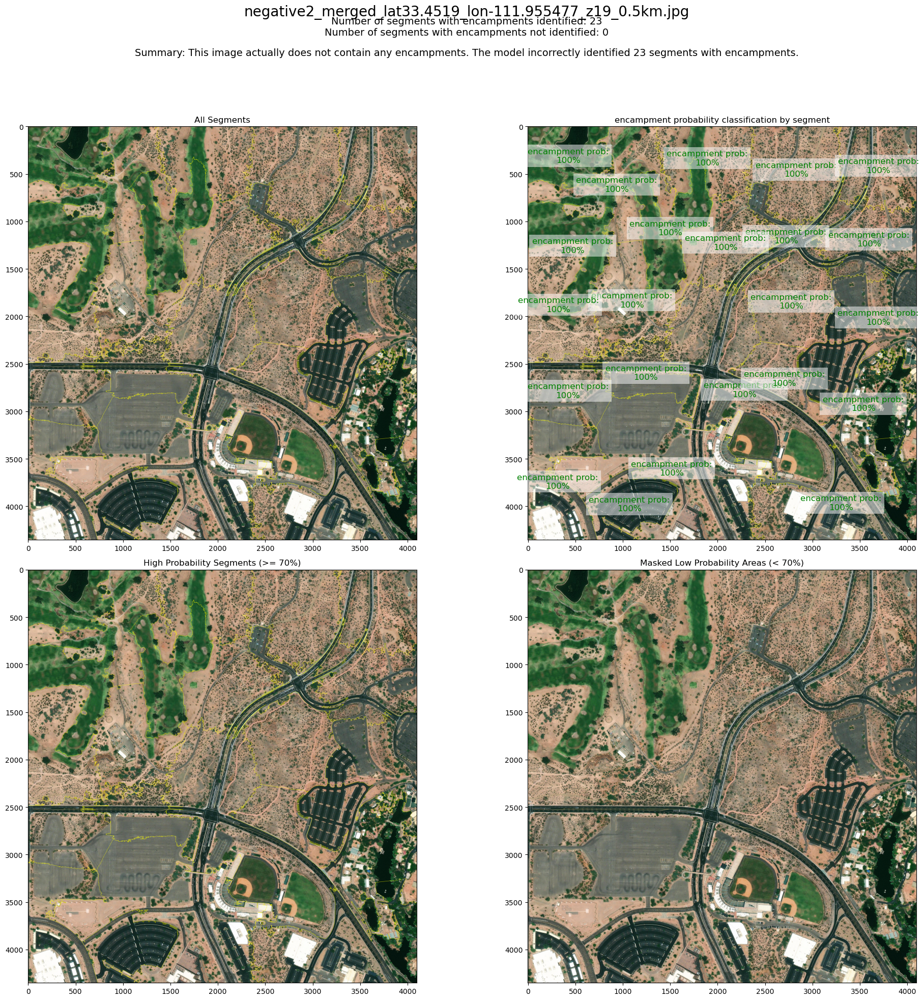

encampment detected!
Number of segments: 22
Number of labels: 22


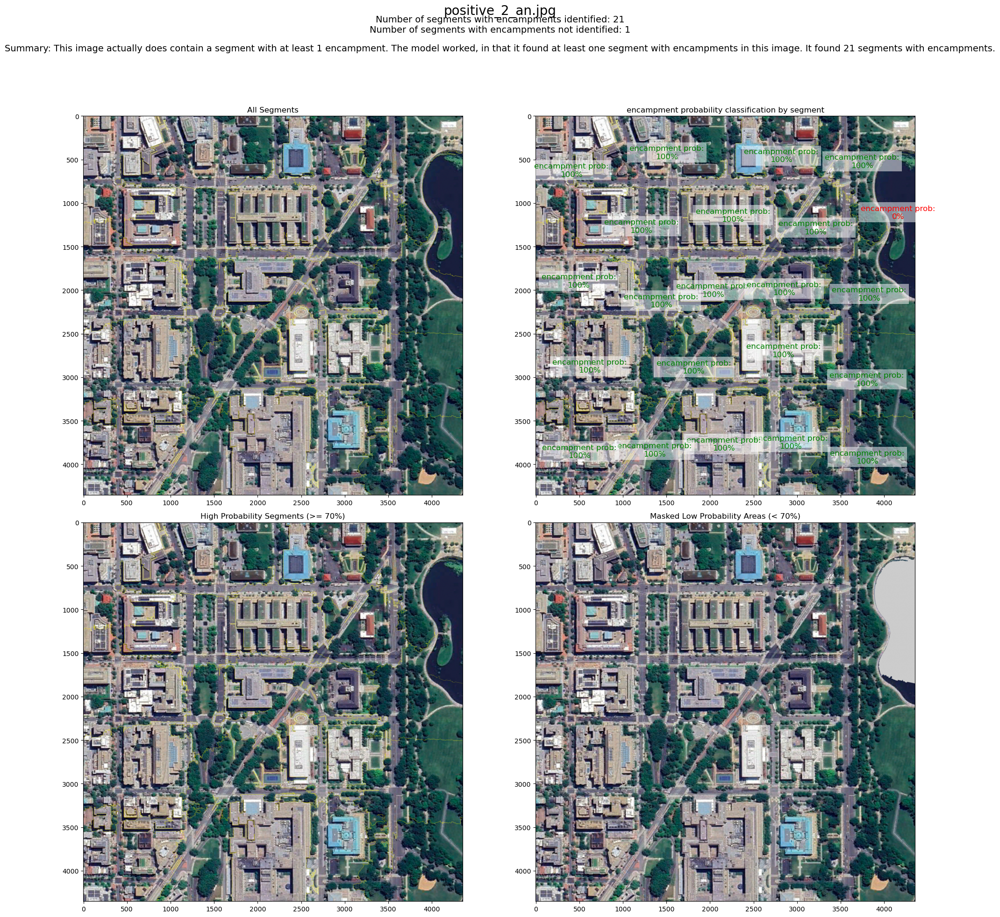

encampment detected!
Number of segments: 19
Number of labels: 19


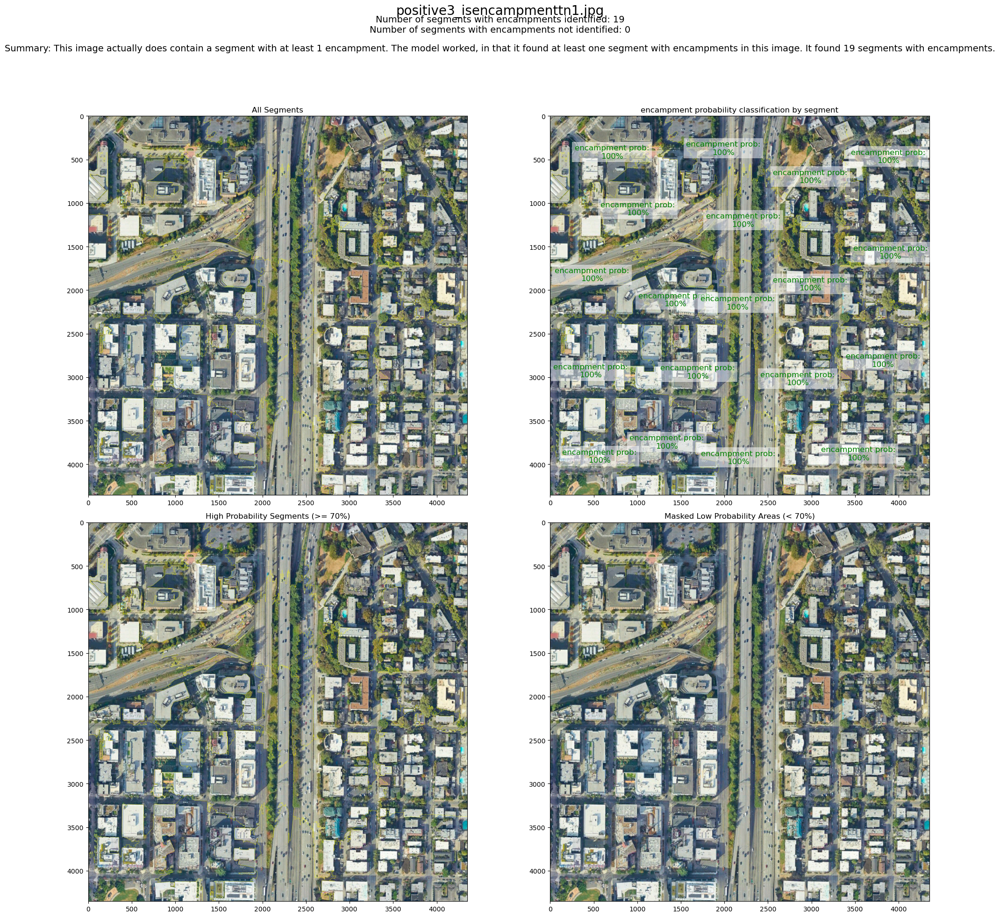

In [ ]:
###
# Define Helper functions to process images

# Function to create segments from each tile image
def slic_segments(name):
    img = img_as_float(io.imread(name))
    return slic(img, n_segments=30, compactness=35, sigma=1)

# Function to prepare each segment for classification
def prepare_segment(segment_info, parent_image_object, target_size=(224, 224)):
    width_height_tuple = (target_size[1], target_size[0])
    y0, x0, y1, x1 = segment_info.bbox
    segment_size = (y1 - y0, x1 - x0)
    
    cropped = parent_image_object.crop((x0, y0, x1, y1))
        
    if segment_size != width_height_tuple:
        resample = Image.NEAREST
        cropped = cropped.resize(width_height_tuple, resample)
        
    return cropped

# Function to extract features from image using Resnet50
def features_from_tile(img_name, resnet, batch_size=64):
    segments = [] 
    # Get geometry info about each segment
    segments_info = regionprops(slic_segments(img_name))      
    image_object = Image.open(img_name)
    
    n = len(segments_info)
    img_array = np.zeros((n, 224, 224, 3))
    
    for i, s in enumerate(segments_info):
        img = prepare_segment(s, image_object)
        img = image.img_to_array(img)
        img = preprocess_input(img)
        img_array[i] = img
    
    # Predict features
    X = resnet.predict(img_array, batch_size=batch_size, verbose=0)
    return X

# Split to segments, get features, classify segment, return labels for each segment        
def search_in_tile(img_name, classifier, resnet, occurences_treshold=0):
    features = features_from_tile(img_name, resnet)
    features_array = np.array(features)  # Convert features to NumPy array

    # Get predictions
    Y_pred = classifier.predict(features_array)
    
    # Convert numeric predictions to labels
    labels = ['positive' if pred == 1 else 'negative' for pred in Y_pred]
    
    if labels.count("positive") > occurences_treshold:
        print("encampment detected")
    return labels

# Load ResNet model
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

# Define the folder path
folder_path = "./model/datasets/example"

# Get a list of all files in the folder
all_files = os.listdir(folder_path)

# Filter out the image files based on their extensions
image_extensions = ['.png', '.jpg', '.jpeg']  # Add more extensions if needed
file_list = [file for file in all_files if os.path.splitext(file)[1].lower() in image_extensions]

# Prepend the folder path to each file name
file_list = [os.path.join(folder_path, file) for file in file_list]


# Function to process each image
def process_image(img_name, clf, resnet):
    # Construct labels using search_in_tile
    labels = search_in_tile(img_name, clf, resnet)

    # Read and preprocess the image
    img = io.imread(img_name)  # image as numpy array
    original_image = Image.fromarray(img.astype('uint8'), 'RGB')  # same image as PIL object
    img = img_as_float(img)  # convert to float, to use for segmentation purposes

    # Split image into segments
    segments_slic = slic(img, n_segments=30, compactness=35, sigma=1)  # split image to segments
    marked_img_all = mark_boundaries(img, segments_slic)  # image with all segments and boundaries

    # Find label values for each segment without encampments
    negative_labels = [i + 1 for i, l in enumerate(labels) if l == 'negative']  # Changed from 0 to 'negative'
    # Create a copy of segments_slic for positive segments
    segments_slic_positive = segments_slic.copy()

    # Filter out from our mask all pixels with values for "negative" segments
    segments_slic_positive[np.isin(segments_slic_positive, negative_labels)] = 0

    # Mark boundaries for positive segments
    marked_img_positive = mark_boundaries(img, segments_slic_positive)  # new image has only boundaries for positive segments

    # Show images in a 2x2 grid
    fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))
    filename = os.path.basename(img_name)
    fig.suptitle(f"{filename}", fontsize=20)  # Add the image name as a title above the plots

    ax0.imshow(marked_img_all)
    ax0.set_title("All Segments")
    ax1.imshow(marked_img_positive)
    ax1.set_title("encampment probability classification by segment")

    # Debugging information
    segments_info = regionprops(segments_slic)
    print(f"Number of segments: {len(segments_info)}")
    print(f"Number of labels: {len(labels)}")

    # Ensure the number of labels matches the number of segments
    if len(labels) < len(segments_info):
        labels.extend([-1] * (len(segments_info) - len(labels)))  # Add placeholder labels for missing segments

    # Create a mask for segments with encampment probability >= 70%
    segments_slic_high_prob = segments_slic.copy()
    high_prob_count = 0
    low_prob_count = 0
    for i, segment in enumerate(segments_info):
        label = labels[i]
        centroid = segment.centroid
        
        # Convert label to probability value
        percentage = 100 if label == "positive" else 0
        label_text = f"encampment prob:\n{percentage}%"
        
        # Set color based on label
        color = 'green' if label == "positive" else 'red'
        ax1.text(centroid[1], centroid[0], label_text, 
                color=color, fontsize=12, ha='center', va='center', 
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
        
        # Count positives and negatives
        if label == "positive":
            high_prob_count += 1
        else:
            low_prob_count += 1
            segments_slic_high_prob[segments_slic == (i + 1)] = 0

    # Mark boundaries for high probability segments
    marked_img_high_prob = mark_boundaries(img, segments_slic_high_prob)
    ax2.imshow(marked_img_high_prob)
    ax2.set_title("High Probability Segments (>= 70%)")

    # Mask areas below 70% with solid light grey
    masked_img = img.copy()
    masked_img[segments_slic_high_prob == 0] = [0.8, 0.8, 0.8]  # light grey color
    ax3.imshow(masked_img)
    ax3.set_title("Masked Low Probability Areas (< 70%)")

    # Add subheading with counts
    fig.text(0.5, 0.95, f"Number of segments with encampments identified: {high_prob_count}\nNumber of segments with encampments not identified: {low_prob_count}", ha='center', fontsize=14)

    # Add summary based on filename
    if "negative" in filename.lower():
        if high_prob_count == 0:
            summary = "This image actually does not contain any encampments. The model correctly identified 0 segments with encampments."
        else:
            summary = f"This image actually does not contain any encampments. The model incorrectly identified {high_prob_count} segments with encampments."
    elif "positive" in filename.lower():
        if high_prob_count > 0:
            summary = f"This image actually does contain a segment with at least 1 encampment. The model worked, in that it found at least one segment with encampments in this image. It found {high_prob_count} segments with encampments."
        else:
            summary = "This image actually does contain a segment with at least 1 encampment. The model incorrectly predicted that there are no segments with encampments in this picture."
    else:
        summary = ""

    fig.text(0.5, 0.93, f"Summary: {summary}", ha='center', fontsize=14)

    fig.tight_layout(rect=[0, 0, 1, 0.90])  # Adjust layout to make room for the title and subheading
    plt.show()

# Loop through the file_list and process each image
for file in file_list:
    process_image(file, clf, resnet)